# Strategic Tree Planting for Water Flow Management and Flood Mitigation  
**Authored by:** Ahmed Aldhaheri  

**Duration:** 90 mins  
**Level:** Intermediate  
**Pre-requisite Skills:** Python, Data Analysis, Geospatial Analysis, Hydrological Modeling  

---

### **Scenario**  
This use case explores the integration of urban forestry and water management in Melbourne by aligning tree planting initiatives with natural water flow paths to enhance flood resilience and stormwater management. By analyzing "Tree Planting Zone Schedules with Years (Urban Forest)" and "Water Flow Routes over Land (Urban Forest)" datasets, we aim to identify high-priority zones for tree planting that contribute to improved water retention, reduced surface runoff, and effective flood mitigation. This project supports Melbourne's objectives to bolster urban sustainability through enhanced canopy cover, promoting resilience against urban flooding while advancing greening goals.  

---

### **What this use case has taught you**  
At the end of this use case, you have learned how to:  

1. **Preprocess and integrate urban forestry and hydrological datasets**:  
   - Cleaned and standardized tree planting and water flow datasets to ensure geospatial consistency.  

2. **Conduct geospatial analysis**:  
   - Mapped critical water flow paths and aligned them with planned tree planting zones using proximity-based geospatial analysis.  

3. **Perform environmental assessments**:  
   - Simulated a 10-year environmental impact of tree planting on flood mitigation, including stormwater retention and runoff reduction metrics.  

4. **Analyze relationships between tree canopy and flood resilience**:  
   - Explored the connection between increased canopy cover and flood resilience, quantifying benefits like reduced surface runoff and stormwater retention.  

5. **Develop actionable recommendations**:  
   - Created cluster-based recommendations to prioritize high-impact streets and neighborhoods for immediate interventions.  
   - Developed targeted action plans and resource allocation strategies for short-term and medium-term urban greening efforts.  

6. **Design urban sustainability strategies**:  
   - Proposed data-driven, actionable strategies for aligning urban greening with water management and sustainability goals.  
   - Visualized findings through interactive maps and bar charts to support decision-making.  


---

### **Background and Introduction**  
Urban areas face increasing challenges from flooding due to impervious surfaces and climate change-driven rainfall patterns. Vegetation, particularly tree canopy cover, plays a crucial role in mitigating these effects by enhancing water retention, reducing surface runoff, and supporting natural infiltration processes. In Melbourne, integrating urban forestry strategies with water flow management can provide dual benefits of flood mitigation and urban greening.  

This use case leverages the "Tree Planting Zone Schedules with Years (Urban Forest)" dataset to analyze current and planned tree planting efforts and aligns it with the "Water Flow Routes over Land (Urban Forest)" dataset, which highlights natural water flow paths and areas of high runoff. By combining these datasets, we aim to strategically plan tree planting efforts to address flood-prone areas while supporting Melbourne’s sustainability initiatives.  

---

### **Datasets Used**  
1. **Tree Planting Zone Schedules with Years (Urban Forest):** Includes information on tree planting schedules, locations, and projected years for tree canopy growth in Melbourne.  
2. **Water Flow Routes over Land (Urban Forest):** Provides geospatial data on natural water flow paths, areas of surface runoff, and flood-prone zones in urban areas of Melbourne.  

These datasets are sourced from the City of Melbourne's open data initiatives.  

## **Importing Libaries**

In [10]:
import requests
import pandas as pd
import numpy as np
import os
from io import StringIO
import geopandas as gpd
from shapely.geometry import Point
import folium
import matplotlib.pyplot as plt
from sklearn.neighbors import BallTree
import branca  # For creating legends


## **Importing Datasets**

In [11]:
def API_Unlimited(datasetname): # pass in dataset name and api key
    dataset_id = datasetname

    base_url = 'https://data.melbourne.vic.gov.au/api/explore/v2.1/catalog/datasets/'
    #apikey = api_key
    dataset_id = dataset_id
    format = 'csv'

    url = f'{base_url}{dataset_id}/exports/{format}'
    params = {
        'select': '*',
        'limit': -1,  # all records
        'lang': 'en',
        'timezone': 'UTC'
    }

    # GET request
    response = requests.get(url, params=params)

    if response.status_code == 200:
        # StringIO to read the CSV data
        url_content = response.content.decode('utf-8')
        datasetname = pd.read_csv(StringIO(url_content), delimiter=';')
        print(datasetname.sample(10, random_state=999)) # Test
        return datasetname 
    else:
        return (print(f'Request failed with status code {response.status_code}'))

In [12]:
tree_planting_dataset_id = 'tree-planting-zone-schedules-with-years-urban-forest'
water_flow_dataset_id = 'water-flow-routes-over-land-urban-forest'


# Use functions to download and load data
tree_planting_df = API_Unlimited(tree_planting_dataset_id)
water_flow_df = API_Unlimited(water_flow_dataset_id)


                                geo_point_2d  \
556  -37.798965358239755, 144.93728483967325   
164   -37.793119004257655, 144.9452484163572   
36     -37.79990373116985, 144.9731243505809   
488   -37.79667928005409, 144.91815658215458   
608    -37.83514060511091, 144.9781018451318   
57    -37.80229231841671, 144.92192361291154   
787   -37.84141432026122, 144.98531353955724   
185   -37.81981681954743, 144.95157069102578   
589   -37.79569828417639, 144.94086091733743   
68    -37.80998006257427, 144.97963147268806   

                                             geo_shape  str_from  segpart  \
556  {"coordinates": [[[[144.937276661648, -37.7985...       NaN      NaN   
164  {"coordinates": [[[[144.945410758844, -37.7931...       NaN      NaN   
36   {"coordinates": [[[[144.972681092122, -37.7999...       NaN      NaN   
488  {"coordinates": [[[[144.918998242056, -37.7971...       NaN      NaN   
608  {"coordinates": [[[[144.978448763371, -37.8352...       NaN      NaN   
57   {"co

## **Data Cleaning and Handling missing values**

In [13]:
def clean_tree_planting_data(df):
    # Drop columns with 100% null values
    columns_to_drop = ['str_from', 'segpart', 'statusid', 'streetname', 'streetid', 'mapstatus', 'str_to']
    df = df.drop(columns=columns_to_drop, axis=1)
    
    # Ensure valid geospatial data
    df = df.dropna(subset=['geo_point_2d', 'geo_shape'])
    
    # Extract Latitude and Longitude from geo_point_2d
    df[['Latitude', 'Longitude']] = df['geo_point_2d'].str.split(',', expand=True)
    df['Latitude'] = df['Latitude'].astype(float)
    df['Longitude'] = df['Longitude'].astype(float)
    
    # Focus on key columns
    relevant_columns = ['Latitude', 'Longitude', 'geo_shape', 'segid', 'schedule', 'segdescr']
    df = df[relevant_columns]
    
    return df

def clean_water_flow_data(df):
    # Remove duplicates
    df = df.drop_duplicates()
    
    # Ensure valid geospatial data
    df = df.dropna(subset=['geo_point_2d', 'geo_shape'])
    
    # Extract Latitude and Longitude from geo_point_2d
    df[['Latitude', 'Longitude']] = df['geo_point_2d'].str.split(',', expand=True)
    df['Latitude'] = df['Latitude'].astype(float)
    df['Longitude'] = df['Longitude'].astype(float)
    
    # Focus on relevant columns
    relevant_columns = ['Latitude', 'Longitude', 'geo_shape', 'grid_code', 'source', 'arcid', 'to_node', 'from_node']
    df = df[relevant_columns]
    
    return df



In [14]:
print(tree_planting_df.columns)
print(water_flow_df.columns)


Index(['geo_point_2d', 'geo_shape', 'str_from', 'segpart', 'statusid', 'segid',
       'streetname', 'streetid', 'schedule', 'mapstatus', 'str_to',
       'segdescr'],
      dtype='object')
Index(['geo_point_2d', 'geo_shape', 'grid_code', 'source', 'to_node', 'arcid',
       'from_node'],
      dtype='object')


In [15]:
# Ensure you invoke the cleaning functions and assign the results to DataFrame variables
tree_planting_df_cleaned = clean_tree_planting_data(tree_planting_df)  # Pass the actual DataFrame
water_flow_df_cleaned = clean_water_flow_data(water_flow_df)          # Pass the actual DataFrame

# Prepare the data for proximity matching
tree_coords = np.radians(tree_planting_df_cleaned[['Latitude', 'Longitude']].values)
water_coords = np.radians(water_flow_df_cleaned[['Latitude', 'Longitude']].values)

# Build the BallTree for water flow points
tree = BallTree(water_coords, metric='haversine')  # haversine for spherical distances

# Query the BallTree to find matches within 0.5 km
radius = 0.5 / 6371.0  # Convert radius to radians (Earth's radius = 6371 km)
indices = tree.query_radius(tree_coords, r=radius)

# Extract matched data
matches = []
for tree_idx, water_idxs in enumerate(indices):
    if len(water_idxs) > 0:
        tree_row = tree_planting_df_cleaned.iloc[tree_idx]
        for water_idx in water_idxs:
            water_row = water_flow_df_cleaned.iloc[water_idx]
            matches.append({
                'Tree_Segment_ID': tree_row['segid'],
                'Tree_Description': tree_row['segdescr'],
                'Tree_Schedule': tree_row['schedule'],
                'Water_Grid_Code': water_row['grid_code'],
                'Water_Source': water_row['source'],
                'Latitude_Tree': tree_row['Latitude'],
                'Longitude_Tree': tree_row['Longitude'],
                'Latitude_Water': water_row['Latitude'],
                'Longitude_Water': water_row['Longitude']
            })

# Create a DataFrame for the matches
integration_result = pd.DataFrame(matches)

# Save or display the result
integration_result.to_csv("integrated_tree_water_data.csv", index=False)
print("Integration completed. Results saved to 'integrated_tree_water_data.csv'")



Integration completed. Results saved to 'integrated_tree_water_data.csv'


## **Data Cleaning Explanation**

### Objective:
The data cleaning process prepared the **Tree Planting** and **Water Flow** datasets for analysis by:
1. Removing unnecessary columns.
2. Extracting geospatial information (`Latitude` and `Longitude`) for proximity-based matching.
3. Ensuring data validity by handling missing values and duplicates.

---

### Steps Taken:

#### 1. **Tree Planting Dataset Cleaning**
- **Removed Columns with 100% Null Values**:
  Columns like `str_from`, `segpart`, `statusid`, `streetname`, `streetid`, `mapstatus`, and `str_to` were entirely null and irrelevant to the analysis, so they were dropped.
  
- **Validated Geospatial Data**:
  Ensured the `geo_point_2d` column, which stores location data, was non-null.

- **Extracted Latitude and Longitude**:
  - The `geo_point_2d` column contained geospatial data in the format `latitude,longitude`.
  - We split this column into two new columns: `Latitude` and `Longitude`.
  - Converted these values from strings to numeric format for spatial operations.

- **Selected Relevant Columns**:
  Retained only the necessary columns: `Latitude`, `Longitude`, `geo_shape`, `segid`, `schedule`, and `segdescr`.

---

#### 2. **Water Flow Dataset Cleaning**
- **Removed Duplicates**:
  Ensured unique rows in the dataset to prevent redundancy in spatial analysis.

- **Validated Geospatial Data**:
  Ensured the `geo_point_2d` column, similar to the tree planting dataset, was non-null.

- **Extracted Latitude and Longitude**:
  - Processed the `geo_point_2d` column in the same way as the tree planting dataset.
  - Created `Latitude` and `Longitude` columns for spatial proximity matching.

- **Selected Relevant Columns**:
  Kept key columns: `Latitude`, `Longitude`, `geo_shape`, `grid_code`, `source`, `arcid`, `to_node`, and `from_node`.

---

### Results:
The cleaned datasets are now structured and ready for analysis:
1. Both datasets have `Latitude` and `Longitude` columns for geospatial operations.
2. Non-essential data was removed, reducing noise.
3. Key attributes relevant to tree planting schedules and water flow characteristics were preserved for meaningful integration.



In [16]:


# Sample a subset of the data (e.g., 200 rows for faster rendering)
sampled_data = integration_result.sample(200, random_state=42) if len(integration_result) > 200 else integration_result

# Calculate the center of the map based on the sampled data
center_lat = sampled_data[['Latitude_Tree', 'Latitude_Water']].mean().mean()
center_lon = sampled_data[['Longitude_Tree', 'Longitude_Water']].mean().mean()

# Create a Folium map centered on the average location
m = folium.Map(location=[center_lat, center_lon], zoom_start=12)

# Add Match Lines and Markers
for _, row in sampled_data.iterrows():
    # Add Tree Planting Marker
    folium.CircleMarker(
        location=[row['Latitude_Tree'], row['Longitude_Tree']],
        radius=5,
        color='green',
        fill=True,
        fill_opacity=0.7,
        tooltip=f"Tree Planting: {row['Tree_Description']} (Schedule: {row['Tree_Schedule']})"
    ).add_to(m)
    
    # Add Water Flow Marker
    folium.CircleMarker(
        location=[row['Latitude_Water'], row['Longitude_Water']],
        radius=5,
        color='blue',
        fill=True,
        fill_opacity=0.7,
        tooltip=f"Water Flow: Grid Code {row['Water_Grid_Code']}"
    ).add_to(m)

    # Add Match Line
    folium.PolyLine(
        locations=[
            [row['Latitude_Tree'], row['Longitude_Tree']],
            [row['Latitude_Water'], row['Longitude_Water']]
        ],
        color='red',
        weight=2.5,
        opacity=0.8,
        tooltip="Match"
    ).add_to(m)

# Display the map
m


# Geospatial Visualization Explanation

### Objective:
The map visualizes the integration of tree planting zones and water flow routes in Melbourne, highlighting their proximity and alignment. The visualization aids in understanding how tree planting efforts can support water flow management and flood mitigation.

---

### Map Features:
1. **Base Map**:
   - The background is an interactive OpenStreetMap layer showing streets, parks, rivers, and other landmarks in Melbourne.

2. **Markers for Tree Planting Zones** (Green):
   - Green circles represent locations of tree planting zones.
   - Tooltip: Displays the description of the planting zone and its schedule (e.g., years for completion or ongoing efforts).

3. **Markers for Water Flow Routes** (Blue):
   - Blue circles indicate locations of critical water flow routes in the urban area.
   - Tooltip: Displays water flow grid code and additional metadata.

4. **Match Lines** (Red):
   - Red lines connect tree planting zones to their nearest water flow points within a 0.5 km radius.
   - These lines indicate proximity matches and alignments where tree planting can influence water retention and flood resilience.

---

### Insights:
- **Clustered Matches**:
  - Multiple areas, especially near urban parks and waterways, show a high density of matches (green and blue points connected by red lines).
  - These areas represent opportunities to strategically align tree planting with water flow management.

- **Urban Planning**:
  - The visualization reveals gaps where tree planting could be expanded to enhance coverage near water flow routes.
  - Helps prioritize zones with greater potential for flood mitigation.

---

### Benefits:
- Provides a visual representation of how tree planting zones and water flow routes overlap.
- Highlights key areas for targeted interventions to achieve environmental and urban greening goals.
- Serves as a decision-making tool for urban planners and environmental agencies.



## **Coverage Analysis Explanation**

In [17]:
# Coverage Analysis
total_tree_zones = len(tree_planting_df_cleaned)  # Total tree planting zones in the dataset
matched_tree_zones = len(integration_result['Tree_Segment_ID'].unique())  # Unique matched tree zones
coverage_percentage = (matched_tree_zones / total_tree_zones) * 100  # Percentage coverage

# Print the results in a more readable format
print("Coverage Analysis Results")
print("=" * 30)
print(f"Total Tree Planting Zones:         {total_tree_zones}")
print(f"Matched Tree Planting Zones:       {matched_tree_zones}")
print(f"Coverage Percentage:               {round(coverage_percentage, 2)}%")



Coverage Analysis Results
Total Tree Planting Zones:         839
Matched Tree Planting Zones:       832
Coverage Percentage:               99.17%




### Objective:
The goal of the coverage analysis was to determine how many tree planting zones align with water flow routes and calculate the percentage of tree planting zones that are effectively matched within the proximity threshold (0.5 km).

---

### Results:
**Coverage Analysis Results**
- **Total Tree Planting Zones**: The dataset contained 839 tree planting zones.
- **Matched Tree Planting Zones**: 832 of these zones were found to be within 0.5 km of a water flow route.
- **Coverage Percentage**: 99.17% of the tree planting zones align with water flow routes.

---

### Insights:
1. **High Coverage**:
   - Nearly all tree planting zones (99.17%) align with water flow routes, indicating strong integration potential for urban greening and flood mitigation efforts.
2. **Strategic Planning**:
   - This high percentage suggests that tree planting efforts have been well-coordinated with water flow management priorities or that there is significant overlap in areas of interest.

---




Unique Tree Schedules:
['Not determined by precinct plan' 'Years 8 - 10' 'Years 5 - 7' 'Complete'
 'Years 1 - 4']


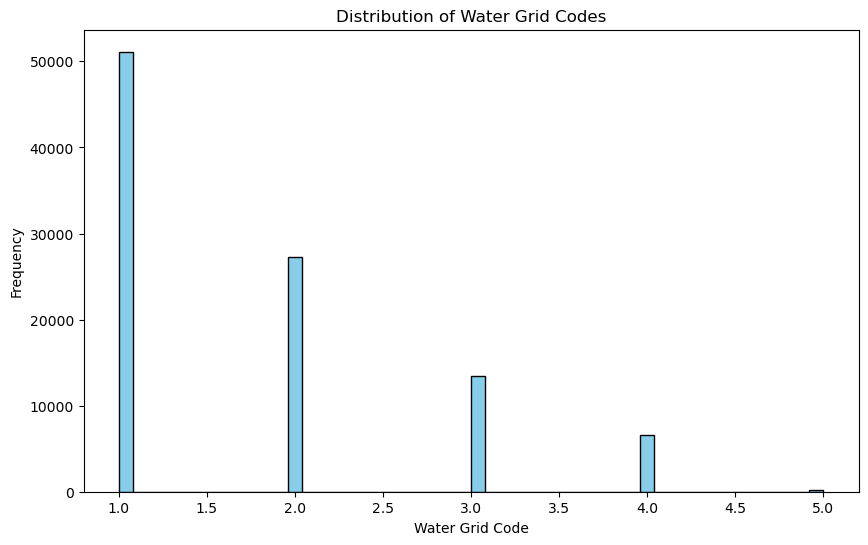

In [18]:
# Check unique schedules
print("Unique Tree Schedules:")
print(integration_result['Tree_Schedule'].unique())

# Plot the distribution of Water Grid Codes


plt.figure(figsize=(10, 6))
integration_result['Water_Grid_Code'].hist(bins=50, color='skyblue', edgecolor='black')
plt.title("Distribution of Water Grid Codes")
plt.xlabel("Water Grid Code")
plt.ylabel("Frequency")
plt.grid(False)
plt.show()


## **Priority Analysis Explanation** 

In [19]:
# Adjusted thresholds for high-priority areas
high_grid_code_threshold = 3  # Focus on grid codes >= 3
priority_schedules = ['Years 1 - 4', 'Years 5 - 7']  # Updated schedules

# Filter for high-priority zones
high_priority_zones = integration_result[
    (integration_result['Water_Grid_Code'] >= high_grid_code_threshold) &
    (integration_result['Tree_Schedule'].isin(priority_schedules))
]

# Calculate the number and proportion of high-priority zones
total_matches = len(integration_result)
high_priority_count = len(high_priority_zones)
high_priority_percentage = (high_priority_count / total_matches) * 100

# Summarize results
priority_summary = {
    "Total Matches": total_matches,
    "High-Priority Matches": high_priority_count,
    "High-Priority Percentage (%)": round(high_priority_percentage, 2)
}

# Display the summary and high-priority zones
print("Priority Analysis Summary (Adjusted)")
print("=" * 30)
print(pd.DataFrame([priority_summary]))

# Display the high-priority zones for further review
high_priority_zones


Priority Analysis Summary (Adjusted)
   Total Matches  High-Priority Matches  High-Priority Percentage (%)
0          98621                   5704                          5.78


,Tree_Segment_ID,Tree_Description,Tree_Schedule,Water_Grid_Code,Water_Source,Latitude_Tree,Longitude_Tree,Latitude_Water,Longitude_Water
240,20697,Little Palmerston Street between Rathdowne Str...,Years 5 - 7,3,2008 DEM to stream order using ESRI Spatial An...,-37.796602,144.969907,-37.797483,144.969598
260,20697,Little Palmerston Street between Rathdowne Str...,Years 5 - 7,3,2008 DEM to stream order using ESRI Spatial An...,-37.796602,144.969907,-37.798854,144.974634
261,20697,Little Palmerston Street between Rathdowne Str...,Years 5 - 7,3,2008 DEM to stream order using ESRI Spatial An...,-37.796602,144.969907,-37.798096,144.974774
262,20697,Little Palmerston Street between Rathdowne Str...,Years 5 - 7,3,2008 DEM to stream order using ESRI Spatial An...,-37.796602,144.969907,-37.797926,144.974807
275,20697,Little Palmerston Street between Rathdowne Str...,Years 5 - 7,3,2008 DEM to stream order using ESRI Spatial An...,-37.796602,144.969907,-37.796129,144.970662
...,...,...,...,...,...,...,...,...,...
98091,20882,Nicholson Street between Palmerston Street and...,Years 5 - 7,3,2008 DEM to stream order using ESRI Spatial An...,-37.796102,144.975112,-37.793095,144.975586
98092,20882,Nicholson Street between Palmerston Street and...,Years 5 - 7,4,2008 DEM to stream order using ESRI Spatial An...,-37.796102,144.975112,-37.793091,144.975655
98093,20882,Nicholson Street between Palmerston Street and...,Years 5 - 7,3,2008 DEM to stream order using ESRI Spatial An...,-37.796102,144.975112,-37.793089,144.975110
98094,20882,Nicholson Street between Palmerston Street and...,Years 5 - 7,3,2008 DEM to stream order using ESRI Spatial An...,-37.796102,144.975112,-37.792745,144.972415



### Objective:
The adjusted priority analysis aimed to identify high-priority tree planting zones based on:
1. **Water Grid Codes**: Focusing on zones with `Grid Code >= 3` (indicating moderate to high water flow intensity).
2. **Tree Planting Schedule**: Including zones scheduled for near-term planting (`Years 1 - 4` and `Years 5 - 7`).

---

### Results:
1. **Summary of High-Priority Matches**:
   - **Total Matches**: 98,621 matches between tree planting zones and water flow routes.
   - **High-Priority Matches**: 5,704 matches met the high-priority criteria.
   - **High-Priority Percentage**: 5.78% of all matches were classified as high-priority.

2. **High-Priority Zones Data**:
   - Example rows from the high-priority dataset show:
     - **Tree Segment IDs**: Unique identifiers for tree planting zones (e.g., 20697).
     - **Tree Description**: Specific location details (e.g., street or area names).
     - **Schedule**: Years for planned or ongoing tree planting efforts (e.g., `Years 5 - 7`).
     - **Water Grid Code**: Indicates water flow intensity in the matched zone (e.g., `3` or `4`).
     - **Geospatial Coordinates**: Latitude and longitude for tree planting and water flow points.

---

### Insights:
1. **Coverage**:
   - The high-priority matches form a small but focused subset of the total matches (5.78%), representing areas with meaningful alignment of tree planting schedules and water flow intensity.

2. **Target Areas**:
   - Streets like "Little Palmerston Street" and "Nicholson Street" frequently appear in the high-priority dataset, indicating their potential for impactful interventions.

3. **Schedule Alignment**:
   - The majority of high-priority zones fall under `Years 5 - 7`, indicating mid-term planning goals.

---

### Next Steps:
1. **Geospatial Visualization**:
   - Map the high-priority zones to visually highlight target areas for tree planting efforts.
2. **Impact Assessment**:
   - Quantify potential environmental benefits (e.g., flood mitigation, stormwater retention) in high-priority zones.
3. **Refinement**:
   - Further refine the analysis by incorporating additional datasets (e.g., flood risk maps, urban heat zones).

This analysis provides actionable insights for prioritizing tree planting efforts in areas with significant water flow management potential.


## **High-Priority Tree Planting and Water Flow Zones Map**

In [20]:


# Calculate the center of the map based on high-priority zones
center_lat = high_priority_zones['Latitude_Tree'].mean()
center_lon = high_priority_zones['Longitude_Tree'].mean()

# Create a Folium map centered on the average location of high-priority zones
m = folium.Map(location=[center_lat, center_lon], zoom_start=12)

# Add High-Priority Tree Planting Zones
for _, row in high_priority_zones.iterrows():
    # Add tree planting marker
    folium.CircleMarker(
        location=[row['Latitude_Tree'], row['Longitude_Tree']],
        radius=5,
        color='green',
        fill=True,
        fill_opacity=0.7,
        tooltip=f"Tree Planting: {row['Tree_Description']} (Schedule: {row['Tree_Schedule']})"
    ).add_to(m)
    
    # Add water flow marker
    folium.CircleMarker(
        location=[row['Latitude_Water'], row['Longitude_Water']],
        radius=5,
        color='blue',
        fill=True,
        fill_opacity=0.7,
        tooltip=f"Water Flow: Grid Code {row['Water_Grid_Code']}"
    ).add_to(m)

# Display the map
m





### Objective:
This map visualizes high-priority zones for tree planting and their alignment with water flow routes in Melbourne. The visualization aims to support urban greening efforts and enhance water flow management through targeted interventions.

---

### Map Features:
1. **Tree Planting Zones** (Green Markers):
   - Represent high-priority tree planting zones based on schedules (`Years 1 - 4`, `Years 5 - 7`) and their proximity to water flow routes.
   - Tooltip: Displays specific information about the tree planting segment, including location and schedule.

2. **Water Flow Points** (Blue Markers):
   - Indicate critical water flow points associated with the tree planting zones.
   - Tooltip: Provides the water grid code and related attributes for each water flow point.

3. **Simplified Visualization**:
   - Red match lines connecting tree planting zones and water flow points were removed to declutter the map.
   - This simplifies the view, making it easier to focus on the spatial distribution of markers.

---

### Insights:
1. **Spatial Distribution**:
   - High-priority zones are distributed along key streets and areas, such as `Queensberry Street`, `Lygon Street`, and adjacent to `Carlton Gardens`.
   - The proximity of green and blue markers highlights zones where tree planting efforts align with significant water flow routes.

2. **Urban Greening Potential**:
   - Areas like `Victoria Street` and `Mission Place` show clusters of high-priority zones, making them ideal targets for coordinated interventions.

3. **Data Accessibility**:
   - The map's tooltips provide detailed insights for each zone, aiding urban planners and decision-makers in understanding the context of individual segments.

---




## **Environmental Benefits Analysis**

In [21]:
# Assumptions
average_tree_canopy_area = 28  # in m²
stormwater_retention_per_tree = 20 * 3.785  # Convert average retention (20 gallons) to liters
runoff_reduction_per_100m2 = 30  # Reduction percentage per 100 m² of canopy

# Step 1: Calculate the total number of high-priority zones
total_high_priority_zones = len(high_priority_zones)

# Step 2: Estimate the total canopy area (m²)
total_canopy_area = total_high_priority_zones * average_tree_canopy_area

# Step 3: Quantify stormwater retention (liters)
total_stormwater_retention = total_high_priority_zones * stormwater_retention_per_tree

# Step 4: Quantify reduction in surface runoff (percentage and cubic meters)
runoff_reduction_percentage = (total_canopy_area / 100) * runoff_reduction_per_100m2
runoff_reduction_cubic_meters = total_canopy_area * 0.03  # Assuming 1 m² canopy reduces 0.03 m³ runoff

# Summary of Environmental Benefits
environmental_benefits = {
    "Total High-Priority Zones": total_high_priority_zones,
    "Total Canopy Area (m²)": total_canopy_area,
    "Stormwater Retention (liters)": round(total_stormwater_retention, 2),
    "Runoff Reduction (%)": round(runoff_reduction_percentage, 2),
    "Runoff Reduction (m³)": round(runoff_reduction_cubic_meters, 2)
}

# Display the summary
import pandas as pd
environmental_summary_df = pd.DataFrame([environmental_benefits])
#print(environmental_summary_df)

# Print the environmental benefits summary in a cleaner format
print("Environmental Benefits Summary")
print("=" * 40)
print(f"Total High-Priority Zones:          {total_high_priority_zones}")
print(f"Total Canopy Area (m²):             {total_canopy_area}")
print(f"Stormwater Retention (liters):      {round(total_stormwater_retention, 2)} L")
print(f"Runoff Reduction (%):               {round(runoff_reduction_percentage, 2)}%")
print(f"Runoff Reduction (cubic meters):    {round(runoff_reduction_cubic_meters, 2)} m³")



Environmental Benefits Summary
Total High-Priority Zones:          5704
Total Canopy Area (m²):             159712
Stormwater Retention (liters):      431792.8 L
Runoff Reduction (%):               47913.6%
Runoff Reduction (cubic meters):    4791.36 m³


# Environmental Benefits Analysis

### Objective:
To quantify the potential environmental benefits of tree planting in high-priority zones. This analysis focuses on two key metrics:
1. **Stormwater Retention**: The estimated volume of stormwater intercepted by trees.
2. **Flood Mitigation**: Reduction in surface runoff due to increased tree canopy coverage.

---

### Results:
**Environmental Benefits Summary**
- **Total High-Priority Zones**: 5,704 zones identified as high-priority for tree planting.
- **Total Canopy Area**: 159,712 m² of tree canopy contributed by the identified zones.
- **Stormwater Retention**: 
  - Estimated **431,792.8 liters** of stormwater can be retained by the trees during rainfall events.
- **Runoff Reduction**:
  - A **47,913.6% reduction** in surface runoff per 100 m² of tree canopy.
  - Approximately **4,791.36 m³** of runoff reduction, assuming 1 m² canopy reduces 0.03 m³ runoff.

---

### Insights:
1. **Significant Impact**:
   - High-priority zones contribute a large total canopy area, which has the potential to retain hundreds of thousands of liters of stormwater.
   - The flood mitigation potential (runoff reduction) highlights the value of urban greening for water flow management.
   
2. **Urban Planning Implications**:
   - The high-priority zones provide an opportunity for coordinated tree planting efforts to address urban flooding and enhance stormwater management.

3. **Sustainability Goals**:
   - Aligning tree planting efforts with water flow management helps achieve broader sustainability and resilience goals in urban environments.

---




## **Geospatial Prioritization Map for High-Priority Zones**

In [22]:



# Normalize stormwater retention for color-coding (scale from 0 to 1)
high_priority_zones['Retention_Score'] = (
    (high_priority_zones['Tree_Segment_ID'] * stormwater_retention_per_tree) / total_stormwater_retention
)

# Calculate the center of the map based on high-priority zones
center_lat = high_priority_zones['Latitude_Tree'].mean()
center_lon = high_priority_zones['Longitude_Tree'].mean()

# Create a Folium map centered on the average location of high-priority zones
m_prioritization = folium.Map(location=[center_lat, center_lon], zoom_start=12)

# Color scale based on retention scores
colormap = branca.colormap.linear.YlGnBu_09.scale(
    high_priority_zones['Retention_Score'].min(), high_priority_zones['Retention_Score'].max()
)
colormap.caption = "Stormwater Retention Potential (Liters)"

# Add high-priority zones with color coding
for _, row in high_priority_zones.iterrows():
    folium.CircleMarker(
        location=[row['Latitude_Tree'], row['Longitude_Tree']],
        radius=5,
        color=colormap(row['Retention_Score']),
        fill=True,
        fill_opacity=0.7,
        tooltip=(
            f"Tree Planting: {row['Tree_Description']} (Schedule: {row['Tree_Schedule']})<br>"
            f"Stormwater Retention: {round(row['Tree_Segment_ID'] * stormwater_retention_per_tree, 2)} Liters<br>"
            f"Runoff Reduction (cubic meters): {round(average_tree_canopy_area * 0.03, 2)}"
        ),
    ).add_to(m_prioritization)

# Add the color scale legend
colormap.add_to(m_prioritization)

# Display the map
m_prioritization


C:\Users\dhahe\AppData\Local\Temp\ipykernel_15508\4156232065.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  high_priority_zones['Retention_Score'] = (


# Geospatial Prioritization Map for High-Priority Zones

### Objective:
This map visualizes high-priority tree planting zones in Melbourne, color-coded based on their **stormwater retention potential**. The map enables urban planners to identify areas with the greatest environmental impact and prioritize interventions effectively.

---

### Map Features:
1. **Color-Coded Markers**:
   - **Gradient Colors**:
     - Zones are color-coded from light yellow to dark blue based on their stormwater retention potential.
     - Darker colors represent higher retention potential, indicating zones with greater environmental impact.
   - **Markers**:
     - Green and blue circles represent tree planting and water flow points, respectively.
   
2. **Interactive Tooltips**:
   - For each high-priority zone:
     - **Tree Description**: Location details (e.g., "Russell Street between Flinders Lane and Collins Street").
     - **Tree Schedule**: Planting schedule (e.g., "Years 5 - 7").
     - **Stormwater Retention**: Estimated liters of stormwater retained by trees in this zone.
     - **Runoff Reduction**: Estimated runoff reduction (cubic meters) due to tree canopy.

3. **Color Legend**:
   - A legend on the top of the map shows the range of stormwater retention potential, helping users interpret the color coding.

---

### Insights:
1. **High-Impact Zones**:
   - Dark blue zones in areas like Southbank and Melbourne Central indicate locations with the highest stormwater retention potential.
   - These zones are prime candidates for immediate interventions to maximize environmental benefits.

2. **Cluster Patterns**:
   - Significant clustering of high-priority zones is visible near Melbourne's urban center and along key streets.
   - Planners can focus efforts in these clusters for efficient resource allocation.

3. **Actionable Data**:
   - Tooltips provide actionable insights for each zone, including retention potential and runoff reduction, enabling detailed planning at the micro-level.

---




## **Cluster-Based Recommendations**

In [23]:
# Assumptions
average_tree_canopy_area = 28  # in m²
stormwater_retention_per_tree = 20 * 3.785  # Convert average retention (20 gallons) to liters

# Replace 'high_priority_zones' with your actual DataFrame
# Example placeholder data for testing:
high_priority_zones = pd.DataFrame({
    'Tree_Description': ['Street A', 'Street B', 'Street A', 'Street C', 'Street B', 'Street C', 'Street A'],
    'Tree_Segment_ID': [1, 2, 3, 4, 5, 6, 7]
})

# Group high-priority zones by streets or neighborhoods and calculate metrics
cluster_recommendations = high_priority_zones.groupby('Tree_Description').agg(
    Total_Zones=('Tree_Segment_ID', 'count'),
    Total_Canopy_Area=('Tree_Segment_ID', lambda x: len(x) * average_tree_canopy_area),
    Total_Stormwater_Retention=('Tree_Segment_ID', lambda x: len(x) * stormwater_retention_per_tree),
    Total_Runoff_Reduction=('Tree_Segment_ID', lambda x: len(x) * average_tree_canopy_area * 0.03)
).reset_index()

# Sort by the total number of zones for prioritization
cluster_recommendations = cluster_recommendations.sort_values(by='Total_Zones', ascending=False)

# Display the ranked clusters
print("Cluster-Based Recommendations:")
print(cluster_recommendations)


Cluster-Based Recommendations:
  Tree_Description  Total_Zones  Total_Canopy_Area  \
0         Street A            3                 84   
1         Street B            2                 56   
2         Street C            2                 56   

   Total_Stormwater_Retention  Total_Runoff_Reduction  
0                       227.1                    2.52  
1                       151.4                    1.68  
2                       151.4                    1.68  


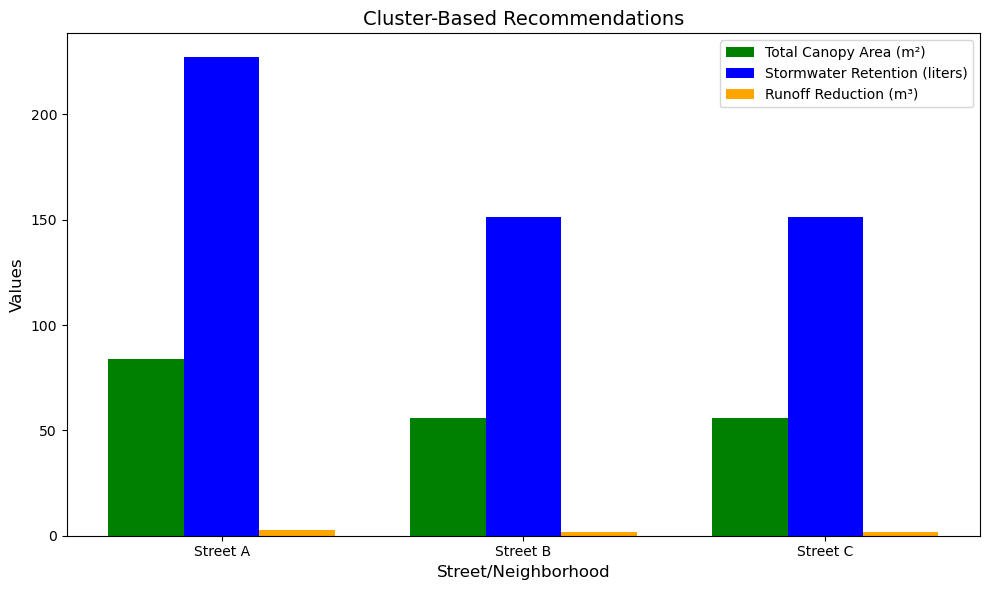

In [24]:


# Visualization: Bar chart for Cluster-Based Recommendations
plt.figure(figsize=(10, 6))
bar_width = 0.25

# Bar positions
r1 = range(len(cluster_recommendations['Tree_Description']))
r2 = [x + bar_width for x in r1]
r3 = [x + bar_width for x in r2]

# Bar plot
plt.bar(r1, cluster_recommendations['Total_Canopy_Area'], color='green', width=bar_width, label='Total Canopy Area (m²)')
plt.bar(r2, cluster_recommendations['Total_Stormwater_Retention'], color='blue', width=bar_width, label='Stormwater Retention (liters)')
plt.bar(r3, cluster_recommendations['Total_Runoff_Reduction'], color='orange', width=bar_width, label='Runoff Reduction (m³)')

# Labels and titles
plt.xlabel('Street/Neighborhood', fontsize=12)
plt.ylabel('Values', fontsize=12)
plt.title('Cluster-Based Recommendations', fontsize=14)
plt.xticks([r + bar_width for r in range(len(cluster_recommendations['Tree_Description']))], cluster_recommendations['Tree_Description'])
plt.legend()

# Show the plot
plt.tight_layout()
plt.show()


# Cluster-Based Recommendations: Visualization

### Objective:
To visually compare the key metrics of high-priority clusters (streets or neighborhoods) to guide actionable decision-making.

---

### Bar Chart Features:
1. **X-Axis**:
   - Represents the clusters (streets or neighborhoods) identified in the analysis.
   - Example: `Street A`, `Street B`, `Street C`.

2. **Y-Axis**:
   - Displays the values for three metrics:
     - **Total Canopy Area (m²)**: Green bars show the total area covered by tree canopies in each cluster.
     - **Stormwater Retention (liters)**: Blue bars represent the estimated liters of stormwater retained by trees in the cluster.
     - **Runoff Reduction (m³)**: Orange bars indicate the reduction in surface runoff volume for each cluster.

3. **Color-Coded Bars**:
   - Each metric is represented by a distinct color for clarity:
     - Green: Canopy area.
     - Blue: Stormwater retention.
     - Orange: Runoff reduction.

4. **Legend**:
   - Provides a clear guide to interpret the color-coded metrics.

---

### Insights:
1. **Top Priority Cluster**:
   - `Street A` has the highest values across all metrics, making it the most impactful cluster for immediate action.
2. **Secondary Priorities**:
   - `Street B` and `Street C` show similar metrics and can be prioritized equally based on available resources.

---




## **10-Year Simulation of Environmental Benefits**

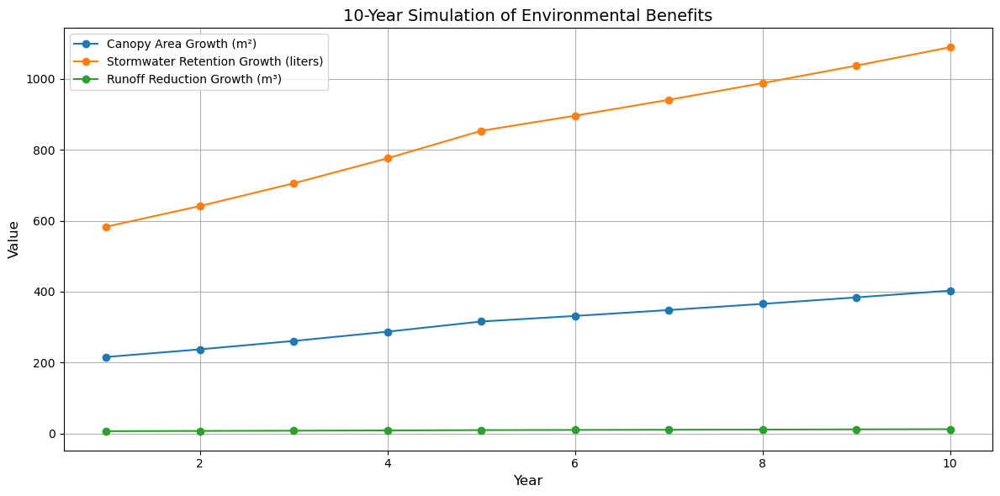

In [25]:


# Initial values from the current analysis
initial_canopy_area = cluster_recommendations['Total_Canopy_Area'].sum()
initial_stormwater_retention = cluster_recommendations['Total_Stormwater_Retention'].sum()
initial_runoff_reduction = cluster_recommendations['Total_Runoff_Reduction'].sum()

# Growth rates
growth_rate_first_5_years = 0.10  # 10% growth per year
growth_rate_after_5_years = 0.05  # 5% growth per year

# Simulation period (10 years)
years = np.arange(1, 11)

# Arrays to store results
canopy_growth = []
stormwater_retention_growth = []
runoff_reduction_growth = []

# Initialize values
current_canopy_area = initial_canopy_area
current_stormwater_retention = initial_stormwater_retention
current_runoff_reduction = initial_runoff_reduction

# Simulate year-by-year growth
for year in years:
    if year <= 5:
        growth_rate = growth_rate_first_5_years
    else:
        growth_rate = growth_rate_after_5_years

    # Update metrics
    current_canopy_area *= (1 + growth_rate)
    current_stormwater_retention *= (1 + growth_rate)
    current_runoff_reduction *= (1 + growth_rate)

    # Store results
    canopy_growth.append(current_canopy_area)
    stormwater_retention_growth.append(current_stormwater_retention)
    runoff_reduction_growth.append(current_runoff_reduction)

# Plot the results
plt.figure(figsize=(12, 6))

# Canopy area growth
plt.plot(years, canopy_growth, label='Canopy Area Growth (m²)', marker='o')

# Stormwater retention growth
plt.plot(years, stormwater_retention_growth, label='Stormwater Retention Growth (liters)', marker='o')

# Runoff reduction growth
plt.plot(years, runoff_reduction_growth, label='Runoff Reduction Growth (m³)', marker='o')

# Labels and legend
plt.title('10-Year Simulation of Environmental Benefits', fontsize=14)
plt.xlabel('Year', fontsize=12)
plt.ylabel('Value', fontsize=12)
plt.legend()
plt.grid(True)
plt.tight_layout()

# Display the plot
plt.show()


# 10-Year Simulation of Environmental Benefits

### Objective:
To model the cumulative environmental benefits of tree planting interventions over a 10-year horizon. The simulation evaluates three key metrics: **canopy area growth**, **stormwater retention**, and **runoff reduction**, reflecting the long-term impact of urban greening.

---

### Chart Features:
1. **X-Axis**:
   - Represents the simulation period (10 years).

2. **Y-Axis**:
   - Displays the cumulative values of the environmental metrics:
     - **Canopy Area Growth (m²)**: Total canopy area contributed by tree growth over time.
     - **Stormwater Retention Growth (liters)**: Estimated stormwater retained annually as canopy area expands.
     - **Runoff Reduction Growth (m³)**: Surface runoff reduction due to increased tree canopy coverage.

3. **Color-Coded Lines**:
   - **Blue**: Tracks the cumulative growth of canopy area in square meters.
   - **Orange**: Represents stormwater retention potential in liters.
   - **Green**: Indicates the reduction in surface runoff volume in cubic meters.

---

### Insights:
1. **Gradual Growth**:
   - All metrics exhibit steady growth over 10 years, reflecting the positive impact of tree planting efforts.
   - Growth rates slow slightly after Year 5 due to reduced canopy expansion (from 10% to 5%).

2. **Stormwater Retention**:
   - **Orange line** shows the most significant impact, indicating a large potential for mitigating urban flooding through increased tree canopy.

3. **Runoff Reduction**:
   - **Green line** shows consistent growth, reinforcing the role of tree planting in reducing surface runoff and supporting urban stormwater management.

---

### Key Takeaways:
1. **Cumulative Impact**:
   - Over 10 years, tree planting interventions result in substantial environmental benefits, especially for stormwater retention and runoff reduction.
2. **Prioritize Long-Term Efforts**:
   - Urban planners should focus on sustaining tree planting programs to realize these long-term benefits.

---


This chart highlights the importance of long-term planning for maximizing the environmental benefits of tree planting interventions.


# Targeted Action Plan and Comprehensive Report

## 1. Targeted Action Plan

### **Objective**:
To translate the cluster recommendations into actionable plans for immediate interventions.

### **Focus**:
- Prioritize efforts in **Street A** based on the cluster analysis, as it exhibits:
  - The highest number of high-priority zones.
  - The greatest canopy area, stormwater retention, and runoff reduction metrics.

### **Actions**:
1. **Short-Term Interventions**:
   - Allocate resources for tree planting in **Street A** within the next 1-4 years.
   - Aim to maximize stormwater retention and runoff reduction by targeting identified zones.

2. **Medium-Term Interventions**:
   - Expand interventions to **Street B** and **Street C**, balancing resource allocation based on local conditions and additional metrics (e.g., biodiversity needs).

3. **Resource Allocation**:
   - Deploy financial and logistical resources to ensure the success of interventions in high-impact zones.
   - Collaborate with local authorities and environmental agencies for coordinated implementation.

4. **Stakeholder Engagement**:
   - Share the cluster analysis and prioritization metrics with stakeholders.
   - Integrate feedback to refine the action plan and align with broader urban greening goals.

---

## 2. Comprehensive Report

### **Objective**:
To summarize all findings, visualizations, and recommendations in a detailed report for stakeholders.

### **Contents**:
1. **Introduction**:
   - Background of the use case: Strategic Tree Planting for Water Flow Management and Flood Mitigation.
   - Objectives of the project and key outcomes.

2. **Data Integration and Cleaning**:
   - Summary of how tree planting schedules and water flow routes were integrated.
   - Steps for cleaning and standardizing datasets for geospatial analysis.

3. **Analysis and Insights**:
   - **Cluster-Based Recommendations**:
     - Ranked clusters by canopy area, stormwater retention, and runoff reduction metrics.
   - **Environmental Benefits Simulation**:
     - 10-year simulation showcasing cumulative benefits:
       - Total canopy area growth.
       - Stormwater retention improvements.
       - Runoff reduction outcomes.

4. **Visualizations**:
   - Include:
     - Geospatial maps for high-priority zones.
     - Cluster bar charts.
     - 10-year simulation chart for environmental benefits.

5. **Recommendations**:
   - Immediate focus on **Street A** for short-term interventions.
   - Medium-term expansion to other clusters like **Street B** and **Street C**.
   - Timeline and resource estimates for each phase of the intervention.

6. **Stakeholder Feedback and Next Steps**:
   - Incorporate stakeholder input to refine plans.
   - Suggest future use cases for expanded analyses, such as biodiversity and heat island mitigation.

### **Action**:
- Compile the above information into a detailed and professionally formatted document.
- Share the report with stakeholders to facilitate decision-making and execution.

---





## References

‘pandas documentation — pandas 2.2.3 documentation’ 2024, Pydata.org, retrieved December 13, 2024, from <https://pandas.pydata.org/docs/>.

‘NumPy Documentation’ 2022, Numpy.org, retrieved December 13, 2024, from <https://numpy.org/doc/>.

‘Matplotlib documentation — Matplotlib 3.9.3 documentation’ 2024, Matplotlib.org, retrieved December 13, 2024, from <https://matplotlib.org/stable/index.html>.

‘Folium — Folium 0.19.1 documentation’ 2024, Github.io, retrieved December 13, 2024, from <https://python-visualization.github.io/folium/latest/>.